In [1]:
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

In [2]:
denuncias = pd.read_csv("../data/processed/denuncias.csv")
establecimientos = pd.read_csv("../data/processed/establecimientos.csv")
matriculas = pd.read_csv("../data/processed/matriculas.csv")
sep_ee = pd.read_csv("../data/processed/sep_establecimientos.csv")
comunas_geo = gpd.read_file("../data/raw/comunas/comunas.shp")

In [3]:
establecimientos["longitud"] = establecimientos["longitud"].replace(0, pd.NA)
establecimientos["latitud"] = establecimientos["latitud"].replace(0, pd.NA)
establecimientos["longitud"] = pd.to_numeric(establecimientos["longitud"])
establecimientos["latitud"] = pd.to_numeric(establecimientos["latitud"])

In [4]:
latest_data = establecimientos.sort_values("agno").groupby("rbd").last().reset_index()

In [5]:
latest_data["rbd"].nunique()

16698

In [6]:
gdf_establecimientos = gpd.GeoDataFrame(
    latest_data.dropna(subset=["longitud", "latitud"]),
    geometry=gpd.points_from_xy(
        latest_data.dropna(subset=["longitud", "latitud"])["longitud"],
        latest_data.dropna(subset=["longitud", "latitud"])["latitud"],
    ),
    crs="EPSG:4326",
)

In [7]:
totaldenuncias_rbd = (
    denuncias.groupby(["rbd"])
    .agg({"rbd": "count"})
    .rename(columns={"rbd": "total_denuncias"})
    .reset_index()
)

In [8]:
gdf_establecimientos: gpd.GeoDataFrame = gdf_establecimientos.merge(
    denuncias.groupby(["rbd"])
    .agg({"rbd": "count"})
    .rename(columns={"rbd": "total_denuncias"})
    .reset_index(),
    on="rbd",
)

In [9]:
gdf_establecimientos.head(2)

,rbd,Unnamed: 0,agno,nom_rbd,cod_reg_rbd,cod_com_rbd,nom_com_rbd,cod_depe,cod_depe2,rural_rbd,latitud,longitud,convenio_pie,ori_religiosa,pago_matricula,pago_mensual,geometry,total_denuncias
0,1,141766,2023,LICEO POLITECNICO ARICA,15,15101,ARICA,6,5,0,-18.487200,-70.295212,1,2,1,1,POINT (-70.29521 -18.4872),24
1,2,141767,2023,PARVULARIO LAS ESPIGUITAS,15,15101,ARICA,6,5,0,-18.469862,-70.302757,1,2,1,1,POINT (-70.30276 -18.46986),2


In [10]:
gdf_establecimientos["rbd"].nunique()

9539

In [11]:
gdf_establecimientos.explore()

In [12]:
import folium

n = folium.Map(location=[-33.45, -70.64], tiles="OpenStreetMap", zoom_start=10)

for ee in gdf_establecimientos.itertuples():
    folium.CircleMarker(
        location=[ee.latitud, ee.longitud],
        popup=(ee.nom_rbd, ee.total_denuncias),
        radius=float(ee.total_denuncias) * 0.07,
        opacity=0.7,
        stroke=False,
        fill=True,
        fill_color="red",
    ).add_to(n)

# A title can be added to the map, if desired.
n.get_root().html.add_child(folium.Element("<h3 align='center'>Denuncias</h3>"))

n

In [13]:
comunas_geo[comunas_geo["Comuna"] == "Arica"].head(2)

,objectid,shape_leng,dis_elec,cir_sena,cod_comuna,codregion,st_area_sh,st_length_,Region,Comuna,Provincia,geometry
223,157,341130.036414,1,1,15101,15,5.370647e+09,386953.254435,Región de Arica y Parinacota,Arica,Arica,"POLYGON ((-7832403.57 -2130553.365, -7832398.1..."


In [14]:
establecimientos.head()

,Unnamed: 0,agno,rbd,nom_rbd,cod_reg_rbd,cod_com_rbd,nom_com_rbd,cod_depe,cod_depe2,rural_rbd,latitud,longitud,convenio_pie,ori_religiosa,pago_matricula,pago_mensual
0,0,2014,1,LICEO POLITECNICO ARICA,15,15101,ARICA,2,1,0,-18.487274,-70.294739,1,2,1,1
1,1,2014,2,PARVULARIO LAS ESPIGUITAS,15,15101,ARICA,2,1,0,-18.469862,-70.302757,1,2,1,1
2,2,2014,3,ESC. PEDRO VICENTE GUTIERREZ TORRES,15,15101,ARICA,2,1,1,-18.503580,-70.260826,0,2,1,1
3,3,2014,4,LICEO OCTAVIO PALMA PEREZ,15,15101,ARICA,2,1,0,-18.474243,-70.308266,1,1,1,1
4,4,2014,5,JOVINA NARANJO FERNANDEZ,15,15101,ARICA,2,1,0,-18.476904,-70.313454,1,7,1,1


# Establecimientos por comunas

<Axes: xlabel='agno'>

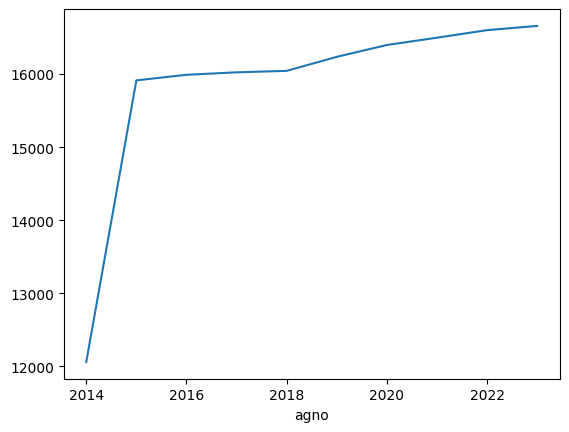

In [15]:
sns.lineplot(
    establecimientos.groupby("agno").size(),
)

<Axes: xlabel='agno'>

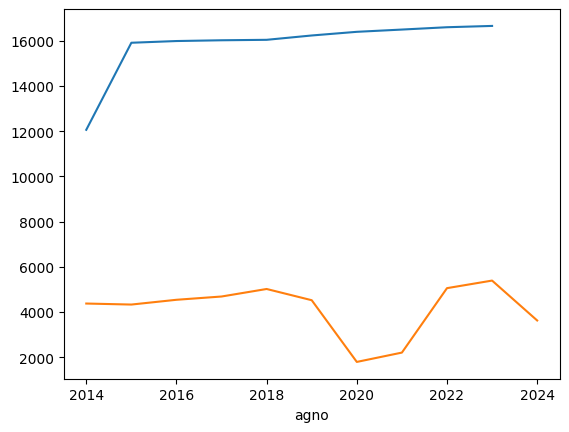

In [16]:
sns.lineplot(
    establecimientos.groupby("agno").size(),
)
sns.lineplot(
    denuncias.groupby(["agno", "rbd"])
    .agg({"rbd": "count"})
    .rename(columns={"rbd": "total_denuncias"})
    .reset_index()
    .groupby("agno")
    .size()
)

## Dataset agrupado por año y comuna, con nº de denuncias nº de matriculas  nº de establecimientos

In [17]:
display(denuncias.info())
display(matriculas.info())
display(establecimientos.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 121768 entries, 0 to 121767
Data columns (total 13 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Unnamed: 0                121768 non-null  int64  
 1   agno                      121768 non-null  int64  
 2   den_canal                 121768 non-null  int64  
 3   den_estado                121768 non-null  int64  
 4   den_fec_creacion          121768 non-null  object 
 5   den_fec_termino_denuncia  116098 non-null  object 
 6   den_oficina               121768 non-null  int64  
 7   den_departamento          121768 non-null  int64  
 8   den_ambito                121768 non-null  object 
 9   den_tema                  121768 non-null  object 
 10  den_subtema               121768 non-null  object 
 11  den_sexo                  121768 non-null  int64  
 12  rbd                       116472 non-null  float64
dtypes: float64(1), int64(7), object(5)
memory us

None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 316850 entries, 0 to 316849
Data columns (total 23 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   Unnamed: 0   316850 non-null  int64 
 1   agno         316850 non-null  int64 
 2   rbd          316850 non-null  int64 
 3   nom_rbd      316370 non-null  object
 4   mat_hom_1    316850 non-null  int64 
 5   mat_muj_1    316850 non-null  int64 
 6   mat_hom_2    316850 non-null  int64 
 7   mat_muj_2    316850 non-null  int64 
 8   mat_hom_3    316850 non-null  int64 
 9   mat_muj_3    316850 non-null  int64 
 10  mat_hom_4    316850 non-null  int64 
 11  mat_muj_4    316850 non-null  int64 
 12  mat_hom_5    316850 non-null  int64 
 13  mat_muj_5    316850 non-null  int64 
 14  mat_hom_6    316850 non-null  int64 
 15  mat_muj_6    316850 non-null  int64 
 16  mat_hom_7    316850 non-null  int64 
 17  mat_muj_7    316850 non-null  int64 
 18  mat_hom_8    316850 non-null  int64 
 19  ma

None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 158425 entries, 0 to 158424
Data columns (total 16 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Unnamed: 0      158425 non-null  int64  
 1   agno            158425 non-null  int64  
 2   rbd             158425 non-null  int64  
 3   nom_rbd         158155 non-null  object 
 4   cod_reg_rbd     158425 non-null  int64  
 5   cod_com_rbd     158425 non-null  int64  
 6   nom_com_rbd     158425 non-null  object 
 7   cod_depe        158425 non-null  int64  
 8   cod_depe2       158425 non-null  int64  
 9   rural_rbd       158425 non-null  int64  
 10  latitud         128468 non-null  float64
 11  longitud        128468 non-null  float64
 12  convenio_pie    158425 non-null  int64  
 13  ori_religiosa   158425 non-null  int64  
 14  pago_matricula  158425 non-null  int64  
 15  pago_mensual    158425 non-null  int64  
dtypes: float64(2), int64(12), object(2)
memory usage: 19.3+ 

None

In [18]:
denuncias_agno_rbd = (
    denuncias.groupby(["agno", "rbd"])
    .agg({"rbd": "count"})
    .rename(columns={"rbd": "total_denuncias"})
    .reset_index()
)

denuncias_matriculas_agno_rbd = pd.merge(
    matriculas, denuncias_agno_rbd, on=["agno", "rbd"], how="left"
)

denuncias_matriculas_agno_rbd["total_denuncias"] = (
    denuncias_matriculas_agno_rbd["total_denuncias"].fillna(0).astype(int)
)


estab_denun_matr_agno_rbd = establecimientos.merge(
    denuncias_matriculas_agno_rbd, on=["agno", "rbd"], how="left"
)

estab_denun_matr_agno_rbd[["total_denuncias", "mat_total"]] = (
    estab_denun_matr_agno_rbd[["total_denuncias", "mat_total"]].fillna(0).astype(int)
)

In [19]:
establecimientos.groupby(["agno", "cod_com_rbd"]).agg({"rbd": "count"}).rename(
    columns={"rbd": "total_establecimientos"}
).reset_index()

,agno,cod_com_rbd,total_establecimientos
0,2014,1101,127
1,2014,1107,51
2,2014,1401,12
3,2014,1402,10
4,2014,1403,5
...,...,...,...
3455,2023,16301,69
3456,2023,16302,40
3457,2023,16303,25
3458,2023,16304,10


In [20]:
estab_denun_matr_agno_rbd.columns

Index(['Unnamed: 0_x', 'agno', 'rbd', 'nom_rbd_x', 'cod_reg_rbd',
       'cod_com_rbd', 'nom_com_rbd', 'cod_depe', 'cod_depe2', 'rural_rbd',
       'latitud', 'longitud', 'convenio_pie', 'ori_religiosa',
       'pago_matricula', 'pago_mensual', 'Unnamed: 0_y', 'nom_rbd_y',
       'mat_hom_1', 'mat_muj_1', 'mat_hom_2', 'mat_muj_2', 'mat_hom_3',
       'mat_muj_3', 'mat_hom_4', 'mat_muj_4', 'mat_hom_5', 'mat_muj_5',
       'mat_hom_6', 'mat_muj_6', 'mat_hom_7', 'mat_muj_7', 'mat_hom_8',
       'mat_muj_8', 'mat_hom_tot', 'mat_muj_tot', 'mat_total',
       'total_denuncias'],
      dtype='object')

In [21]:
estab_denun_matr_agno_comun = (
    estab_denun_matr_agno_rbd.groupby(["agno", "cod_com_rbd", "nom_com_rbd"])
    .agg(
        {"rbd": "count", "total_denuncias": "sum", "mat_total": "sum"},
    )
    .rename(
        columns={"rbd": "total_establecimientos"},
    )
    .reset_index()
)

In [22]:
estab_denun_matr_agno_comun

,agno,cod_com_rbd,nom_com_rbd,total_establecimientos,total_denuncias,mat_total
0,2014,1101,IQUIQUE,254,660,85450
1,2014,1107,ALTO HOSPICIO,102,464,53084
2,2014,1401,POZO ALMONTE,24,10,5870
3,2014,1402,CAMINA,20,0,490
4,2014,1403,COLCHANE,10,4,308
...,...,...,...,...,...,...
3455,2023,16301,SAN CARLOS,138,54,21712
3456,2023,16302,COIHUECO,80,34,9692
3457,2023,16303,ÑIQUÉN,50,8,3540
3458,2023,16304,SAN FABIÁN,20,2,1952


In [23]:
matriculas[matriculas["agno"] == 2023]["mat_total"].sum()

np.int64(7262134)

In [24]:
estab_denun_matr_agno_comun["cod_com_rbd"] = (
    estab_denun_matr_agno_comun["cod_com_rbd"].astype(int).astype(str)
)
comunas_geo["cod_comuna"] = comunas_geo["cod_comuna"].astype(int).astype(str)

In [25]:
estab_denun_mat_geo = estab_denun_matr_agno_comun.merge(
    comunas_geo,
    left_on="cod_com_rbd",
    right_on="cod_comuna",
    how="left",
)

In [26]:
display(comunas_geo.info())
display(estab_denun_matr_agno_comun.info())
display(estab_denun_mat_geo.info())

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 346 entries, 0 to 345
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   objectid    346 non-null    int64   
 1   shape_leng  346 non-null    float64 
 2   dis_elec    346 non-null    int32   
 3   cir_sena    346 non-null    int32   
 4   cod_comuna  346 non-null    object  
 5   codregion   346 non-null    int32   
 6   st_area_sh  346 non-null    float64 
 7   st_length_  346 non-null    float64 
 8   Region      346 non-null    object  
 9   Comuna      346 non-null    object  
 10  Provincia   346 non-null    object  
 11  geometry    346 non-null    geometry
dtypes: float64(3), geometry(1), int32(3), int64(1), object(4)
memory usage: 28.5+ KB


None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3460 entries, 0 to 3459
Data columns (total 6 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   agno                    3460 non-null   int64 
 1   cod_com_rbd             3460 non-null   object
 2   nom_com_rbd             3460 non-null   object
 3   total_establecimientos  3460 non-null   int64 
 4   total_denuncias         3460 non-null   int64 
 5   mat_total               3460 non-null   int64 
dtypes: int64(4), object(2)
memory usage: 162.3+ KB


None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3460 entries, 0 to 3459
Data columns (total 18 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   agno                    3460 non-null   int64   
 1   cod_com_rbd             3460 non-null   object  
 2   nom_com_rbd             3460 non-null   object  
 3   total_establecimientos  3460 non-null   int64   
 4   total_denuncias         3460 non-null   int64   
 5   mat_total               3460 non-null   int64   
 6   objectid                3345 non-null   float64 
 7   shape_leng              3345 non-null   float64 
 8   dis_elec                3345 non-null   float64 
 9   cir_sena                3345 non-null   float64 
 10  cod_comuna              3345 non-null   object  
 11  codregion               3345 non-null   float64 
 12  st_area_sh              3345 non-null   float64 
 13  st_length_              3345 non-null   float64 
 14  Region                  

None

In [27]:
estab_denun_mat_geo

,agno,cod_com_rbd,nom_com_rbd,total_establecimientos,total_denuncias,mat_total,objectid,shape_leng,dis_elec,cir_sena,cod_comuna,codregion,st_area_sh,st_length_,Region,Comuna,Provincia,geometry
0,2014,1101,IQUIQUE,254,660,85450,163.0,404768.386005,2.0,2.0,1101,1.0,2.646244e+09,484872.072869,Región de Tarapacá,Iquique,Iquique,"MULTIPOLYGON (((-7810213.515 -2298008.28, -781..."
1,2014,1107,ALTO HOSPICIO,102,464,53084,340.0,103097.074556,2.0,2.0,1107,1.0,6.603090e+08,110216.581528,Región de Tarapacá,Alto Hospicio,Iquique,"POLYGON ((-7780326.132 -2281256.031, -7780819...."
2,2014,1401,POZO ALMONTE,24,10,5870,22536.0,705627.467575,2.0,2.0,1401,1.0,1.581730e+10,777928.166584,Región de Tarapacá,Pozo Almonte,Iquique,"POLYGON ((-7680137.117 -2263683.92, -7679921.3..."
3,2014,1402,CAMINA,20,0,490,159.0,226896.795617,2.0,2.0,1402,1.0,2.486286e+09,243541.757964,Región de Tarapacá,Camiña,Iquique,"POLYGON ((-7716241.554 -2170371.522, -7716311...."
4,2014,1403,COLCHANE,10,4,308,160.0,304995.923848,2.0,2.0,1403,1.0,4.506264e+09,340576.557549,Región de Tarapacá,Colchane,Iquique,"POLYGON ((-7681876.609 -2149370.334, -7681868...."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3455,2023,16301,SAN CARLOS,138,54,21712,252.0,211209.704434,19.0,10.0,16301,16.0,1.354152e+09,261074.449542,Región de Ñuble,San Carlos,Punilla,"POLYGON ((-8041419.504 -4329139.015, -8040458...."
3456,2023,16302,COIHUECO,80,34,9692,242.0,276848.826499,19.0,10.0,16302,16.0,2.764576e+09,346671.611064,Región de Ñuble,Coihueco,Punilla,"POLYGON ((-7927593.046 -4435376.051, -7927638...."
3457,2023,16303,ÑIQUÉN,50,8,3540,245.0,159257.906431,19.0,10.0,16303,16.0,7.638173e+08,195593.933727,Región de Ñuble,Ñiquén,Punilla,"POLYGON ((-8026032.186 -4319505.012, -8025933...."
3458,2023,16304,SAN FABIÁN,20,2,1952,253.0,311061.932415,19.0,10.0,16304,16.0,2.393007e+09,388109.613857,Región de Ñuble,San Fabián,Punilla,"POLYGON ((-7931328.549 -4363544.179, -7931320...."


In [28]:
import numpy as np

estab_denun_mat_geo["denun_100mat"] = (
    estab_denun_mat_geo["total_denuncias"]
    .divide(estab_denun_mat_geo["mat_total"] * 0.01)
    .replace(np.inf, 0)
)

In [29]:
estab_denun_mat_geo.columns

Index(['agno', 'cod_com_rbd', 'nom_com_rbd', 'total_establecimientos',
       'total_denuncias', 'mat_total', 'objectid', 'shape_leng', 'dis_elec',
       'cir_sena', 'cod_comuna', 'codregion', 'st_area_sh', 'st_length_',
       'Region', 'Comuna', 'Provincia', 'geometry', 'denun_100mat'],
      dtype='object')

In [30]:
estab_denun_mat_geo_agg = (
    estab_denun_mat_geo.groupby(["cod_com_rbd"])
    .agg(
        {
            "nom_com_rbd": "first",
            "total_establecimientos": "sum",
            "total_denuncias": "sum",
            "mat_total": "sum",
            "denun_100mat": "mean",
        },
    )
    .reset_index()
)

In [31]:
estab_denun_mat_geo_agg.to_parquet("../data/processed/aggregated_comunas.parquet")

In [32]:
top_comun_denuncias = estab_denun_mat_geo_agg.nlargest(10, "total_denuncias")

In [33]:
top_comun_denuncias

,cod_com_rbd,nom_com_rbd,total_establecimientos,total_denuncias,mat_total,denun_100mat
71,13119,MAIPU,5424,8690,1994718,0.436191
53,13101,SANTIAGO,4170,7316,1701158,0.429905
85,13201,PUENTE ALTO,5164,6972,2168430,0.322275
62,13110,LA FLORIDA,5962,6550,1550584,0.422595
186,5109,VINA DEL MAR,5644,5204,1202768,0.432323
0,10101,PUERTO MONTT,4780,5100,1146966,0.443124
30,1101,IQUIQUE,3834,4756,883052,0.538864
335,9101,TEMUCO,4726,4380,1312254,0.334059
180,5101,VALPARAISO,4330,4288,1124542,0.382559
165,4101,LA SERENA,4890,4014,1153898,0.345867


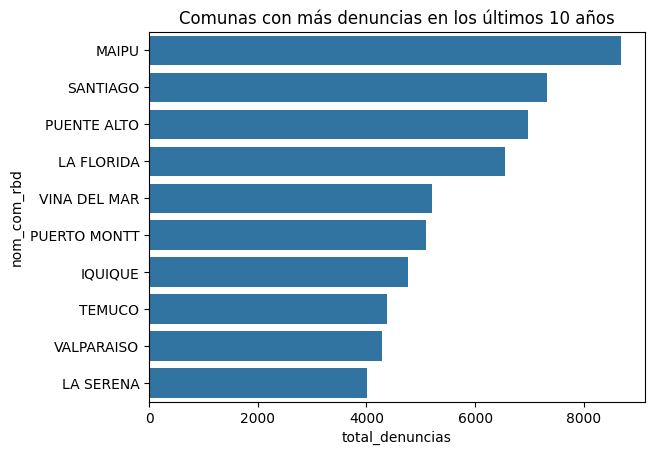

In [34]:
sns.barplot(top_comun_denuncias, x="total_denuncias", y="nom_com_rbd", orient="h")
plt.title("Comunas con más denuncias en los últimos 10 años")
plt.show()

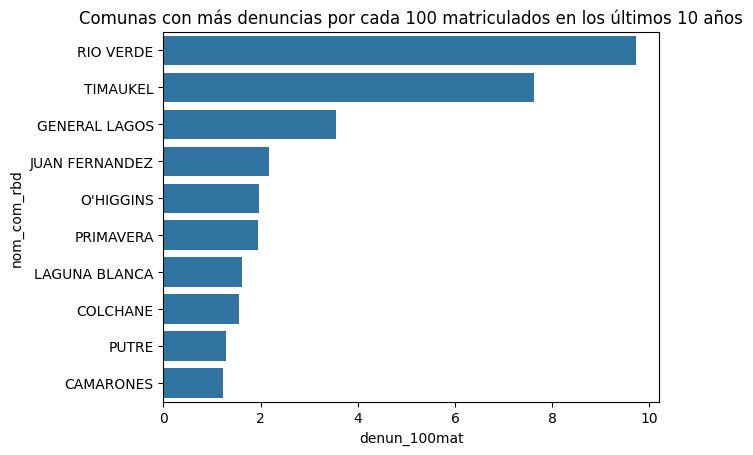

In [35]:
sns.barplot(
    estab_denun_mat_geo_agg.nlargest(10, "denun_100mat"),
    x="denun_100mat",
    y="nom_com_rbd",
    orient="h",
)
plt.title("Comunas con más denuncias por cada 100 matriculados en los últimos 10 años")
plt.show()

## Liceos con más denuncias

In [36]:
estab_denun_matr_agno_rbd = estab_denun_matr_agno_rbd.sort_values(["rbd", "agno"])

In [37]:
estab_denun_matr_agno_rbd.head()

,Unnamed: 0_x,agno,rbd,nom_rbd_x,cod_reg_rbd,cod_com_rbd,nom_com_rbd,cod_depe,cod_depe2,rural_rbd,...,mat_hom_6,mat_muj_6,mat_hom_7,mat_muj_7,mat_hom_8,mat_muj_8,mat_hom_tot,mat_muj_tot,mat_total,total_denuncias
0,0,2014,1,LICEO POLITECNICO ARICA,15,15101,ARICA,2,1,0,...,0,0,363,181,164,172,527,353,880,2
1,0,2014,1,LICEO POLITECNICO ARICA,15,15101,ARICA,2,1,0,...,0,0,363,181,164,172,527,353,880,2
33186,16593,2015,1,LICEO POLITECNICO ARICA,15,15101,ARICA,2,1,0,...,0,0,351,179,222,211,573,390,963,2
33187,16593,2015,1,LICEO POLITECNICO ARICA,15,15101,ARICA,2,1,0,...,0,0,351,179,222,211,573,390,963,2
55950,27975,2016,1,LICEO POLITECNICO ARICA,15,15101,ARICA,2,1,0,...,0,0,353,190,166,193,519,383,902,7


In [38]:
estab_denun_matr_agno_rbd["cambio"] = estab_denun_matr_agno_rbd.groupby("rbd")[
    "total_denuncias"
].diff()

In [39]:
rbd_tendencia = (
    estab_denun_matr_agno_rbd.groupby("rbd")["cambio"]
    .mean()
    .reset_index(name="Cambio Promedio")
)

In [40]:
agnos_con_denuncias = (
    estab_denun_matr_agno_rbd[estab_denun_matr_agno_rbd["total_denuncias"] > 10]
    .groupby("rbd")["agno"]
    .nunique()
    .reset_index(name="años con denuncias")
)

In [41]:
agnos_con_denuncias

,rbd,años con denuncias
0,52,2
1,60,1
2,78,1
3,106,1
4,110,2
...,...,...
500,40414,1
501,40422,2
502,40455,1
503,41124,1


In [42]:
rbd_tendencia = rbd_tendencia.merge(agnos_con_denuncias, on="rbd", how="left")

In [43]:
rbd_tendencia["años con denuncias"] = (
    rbd_tendencia["años con denuncias"].fillna(0).astype(int)
)

In [44]:
rbd_tendencia.nlargest(100, "años con denuncias")

,rbd,Cambio Promedio,años con denuncias
14224,25369,0.631579,9
14567,25749,-0.473684,9
7097,8627,-0.105263,8
13637,24685,0.578947,7
14073,25198,-0.684211,7
...,...,...,...
7697,9534,0.052632,2
8037,10030,0.631579,2
8350,10474,0.315789,2
8376,10505,0.368421,2


In [45]:
rbd_tendencia.nlargest(10, "Cambio Promedio")

,rbd,Cambio Promedio,años con denuncias
9426,12591,3.368421,3
14899,26117,2.736842,4
7387,9071,2.526316,3
16282,41439,2.428571,1
6994,8485,1.631579,6
16537,41919,1.600000,0
16142,41124,1.333333,1
8649,10851,1.210526,1
16506,41859,1.200000,0
4715,5666,1.157895,4


In [46]:
estab_denun_matr_agno_rbd["denun_100mat"] = (
    estab_denun_matr_agno_rbd["total_denuncias"]
    .divide(estab_denun_matr_agno_rbd["mat_total"] * 0.01)
    .replace(np.inf, 0)
)

In [47]:
estab_denun_matr_agno_rbd.groupby("rbd").agg(
    {
        "nom_rbd_x": "first",
        "total_denuncias": "sum",
        "mat_total": "sum",
        "denun_100mat": "mean",
    },
).reset_index()

,rbd,nom_rbd_x,total_denuncias,mat_total,denun_100mat
0,1,LICEO POLITECNICO ARICA,46,15216,0.281981
1,2,PARVULARIO LAS ESPIGUITAS,4,3778,0.104054
2,3,ESC. PEDRO VICENTE GUTIERREZ TORRES,0,9322,0.000000
3,4,LICEO OCTAVIO PALMA PEREZ,52,21550,0.236354
4,5,JOVINA NARANJO FERNANDEZ,52,17724,0.286982
...,...,...,...,...,...
16693,42195,SALA CUNA Y JARDIN INFANTIL ARBOLITO,0,0,NaN
16694,42196,SALA CUNA QUITRAL MONTESSORI,0,0,NaN
16695,42197,SALA CUNA NIDO ALEXANDER MONTESSORI,0,0,NaN
16696,42198,COLEGIO DE ADULTOS AMANECER,0,0,NaN


In [48]:
estab_denun_matr_agno_rbd.columns

Index(['Unnamed: 0_x', 'agno', 'rbd', 'nom_rbd_x', 'cod_reg_rbd',
       'cod_com_rbd', 'nom_com_rbd', 'cod_depe', 'cod_depe2', 'rural_rbd',
       'latitud', 'longitud', 'convenio_pie', 'ori_religiosa',
       'pago_matricula', 'pago_mensual', 'Unnamed: 0_y', 'nom_rbd_y',
       'mat_hom_1', 'mat_muj_1', 'mat_hom_2', 'mat_muj_2', 'mat_hom_3',
       'mat_muj_3', 'mat_hom_4', 'mat_muj_4', 'mat_hom_5', 'mat_muj_5',
       'mat_hom_6', 'mat_muj_6', 'mat_hom_7', 'mat_muj_7', 'mat_hom_8',
       'mat_muj_8', 'mat_hom_tot', 'mat_muj_tot', 'mat_total',
       'total_denuncias', 'cambio', 'denun_100mat'],
      dtype='object')

In [49]:
rbd_tendencia = rbd_tendencia.merge(
    estab_denun_matr_agno_rbd.groupby("rbd")
    .agg(
        {
            "nom_com_rbd": "first",
            "nom_rbd_x": "first",
            "total_denuncias": "sum",
            "mat_total": "sum",
            "denun_100mat": "mean",
        },
    )
    .reset_index(),
    on="rbd",
    how="left",
)

In [50]:
rbd_tendencia.nlargest(10, "denun_100mat")

,rbd,Cambio Promedio,años con denuncias,nom_com_rbd,nom_rbd_x,total_denuncias,mat_total,denun_100mat
9788,13182,0.000000,0,DIEGO DE ALMAGRO,ESC. DE LENGUAJE CREPONIA,12,450,71.726190
12673,20601,0.076923,0,PUERTO VARAS,COLEGIO TERRAVIDA,48,3408,58.090395
5723,6973,-0.052632,0,LOS LAGOS,ESCUELA PARTICULAR SANTA JIMENA,2,4,50.000000
11428,16771,-0.052632,0,SALAMANCA,JARDIN INFANTIL RENACER,2,4,50.000000
10716,14886,0.000000,0,QUILLOTA,ESCUELA DE PARVULOS LILIPUT,6,56,42.857143
875,1073,0.000000,0,LOS VILOS,ESCUELA PARTICULAR EL RINCON,2,6,33.333333
12617,20473,-0.066667,0,TALCA,COLEGIO SAN BENITO,42,112,32.142857
68,87,0.000000,0,GENERAL LAGOS,ESCUELA ANCOLACANE,6,46,30.000000
2561,3189,0.052632,0,CONSTITUCION,ESCUELA TERESA CONSUELO,10,98,23.539683
9287,12226,-0.052632,0,NUNOA,ESCUELA BASICA NÂ°1355 IRARRAZAVAL,22,620,21.225944


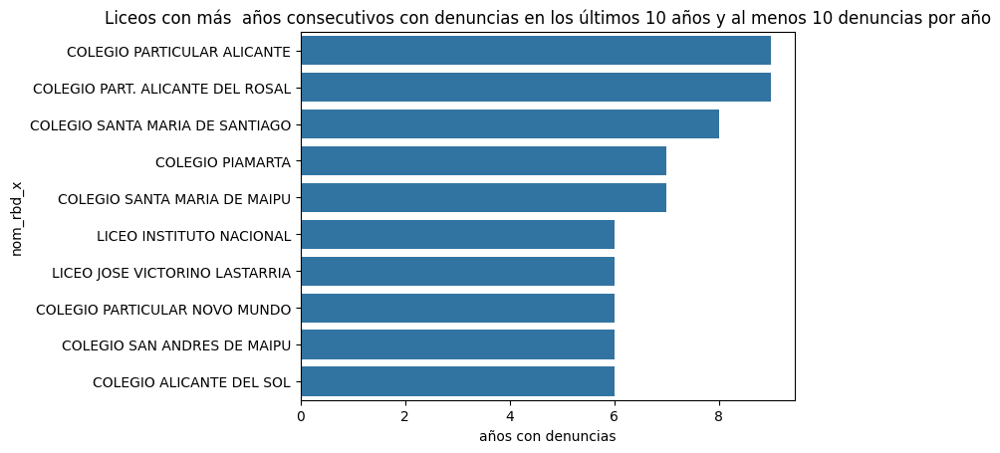

In [51]:
sns.barplot(
    rbd_tendencia.nlargest(10, "años con denuncias"),
    x="años con denuncias",
    y="nom_rbd_x",
    orient="h",
)
plt.title(
    "Liceos con más  años consecutivos con denuncias en los últimos 10 años y al menos 10 denuncias por año"
)
plt.show()

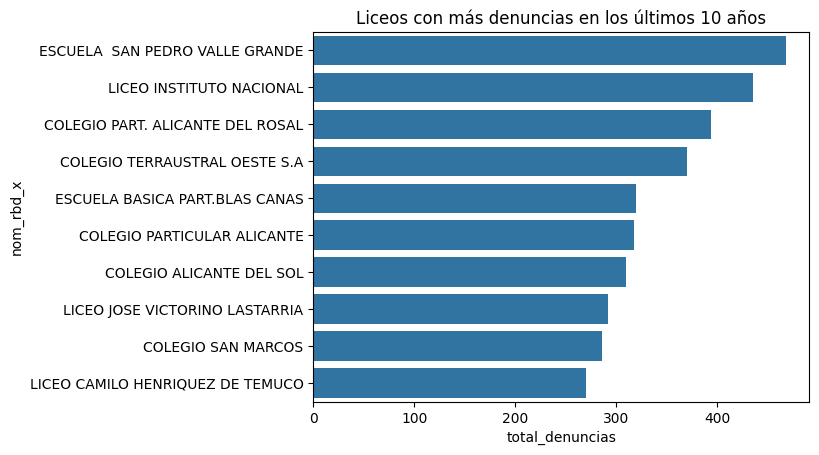

In [52]:
sns.barplot(
    rbd_tendencia.nlargest(10, "total_denuncias"),
    x="total_denuncias",
    y="nom_rbd_x",
    orient="h",
)
plt.title("Liceos con más denuncias en los últimos 10 años")
plt.show()

/workspaces/transparencia-chile-2024/.venv/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 129 (\x81) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


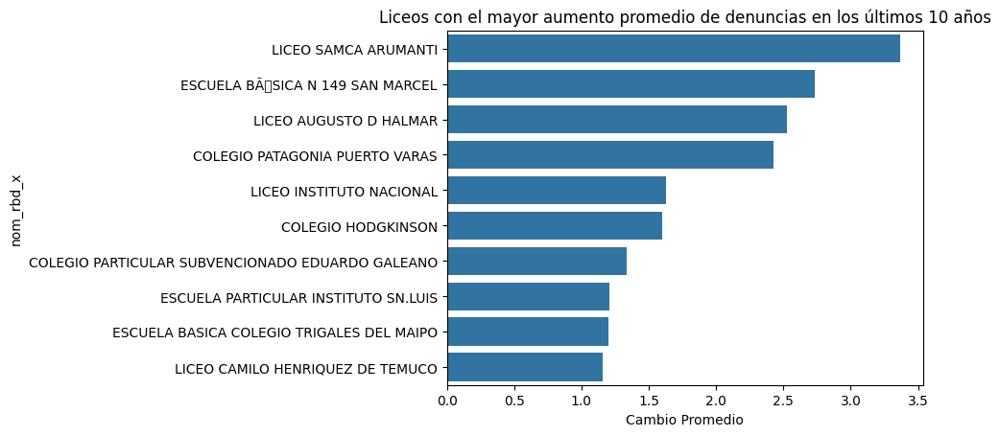

In [53]:
sns.barplot(
    rbd_tendencia.nlargest(10, "Cambio Promedio"),
    x="Cambio Promedio",
    y="nom_rbd_x",
    orient="h",
)
plt.title("Liceos con el mayor aumento promedio de denuncias en los últimos 10 años")
plt.show()

In [54]:
rbd_tendencia.to_parquet("../data/processed/tendencia_ee.parquet")

## SEP

In [55]:
sep_ee.head(1)

,Unnamed: 0,agno,rbd,clasificacion_sep,n_prio,n_ben,convenio_sep,n_prio_ben,n_pref,n_pref_ben
0,0,2014,1,EMERGENTE,655,195,NaN,NaN,NaN,NaN


In [56]:
estab_denun_matr_agno_rbd = estab_denun_matr_agno_rbd.merge(
    sep_ee[["agno", "rbd", "clasificacion_sep", "n_prio", "n_ben"]],
    on=["agno", "rbd"],
    how="left",
)

In [57]:
estab_denun_matr_agno_rbd.columns

Index(['Unnamed: 0_x', 'agno', 'rbd', 'nom_rbd_x', 'cod_reg_rbd',
       'cod_com_rbd', 'nom_com_rbd', 'cod_depe', 'cod_depe2', 'rural_rbd',
       'latitud', 'longitud', 'convenio_pie', 'ori_religiosa',
       'pago_matricula', 'pago_mensual', 'Unnamed: 0_y', 'nom_rbd_y',
       'mat_hom_1', 'mat_muj_1', 'mat_hom_2', 'mat_muj_2', 'mat_hom_3',
       'mat_muj_3', 'mat_hom_4', 'mat_muj_4', 'mat_hom_5', 'mat_muj_5',
       'mat_hom_6', 'mat_muj_6', 'mat_hom_7', 'mat_muj_7', 'mat_hom_8',
       'mat_muj_8', 'mat_hom_tot', 'mat_muj_tot', 'mat_total',
       'total_denuncias', 'cambio', 'denun_100mat', 'clasificacion_sep',
       'n_prio', 'n_ben'],
      dtype='object')

In [58]:
estab_denun_matr_agno_rbd = estab_denun_matr_agno_rbd.drop(
    [
        "Unnamed: 0_x",
        "Unnamed: 0_y",
        "nom_rbd_y",
        "mat_hom_1",
        "mat_muj_1",
        "mat_hom_2",
        "mat_muj_2",
        "mat_hom_3",
        "mat_muj_3",
        "mat_hom_4",
        "mat_muj_4",
        "mat_hom_5",
        "mat_muj_5",
        "mat_hom_6",
        "mat_muj_6",
        "mat_hom_7",
        "mat_muj_7",
        "mat_hom_8",
        "mat_muj_8",
    ],
    axis=1,
)

In [59]:
from typing import Literal

from pandas._libs.missing import NAType


def convert_class_sep(  # noqa: PLR0911
    value: str | NAType,
) -> Literal["AUTONOMA", "EN RECUPERACION"] | NAType:
    """Change the class of sep."""
    if pd.isna(value):
        return pd.NA
    if isinstance(value, str):
        match value.strip():
            case "AUTONOMO":
                return "AUTONOMA"
            case "AUTÓNOMA":
                return "AUTONOMA"
            case "RECUPERACION":
                return "EN RECUPERACION"
            case "RECUPERACIÓN":
                return "EN RECUPERACION"
            case _:
                return value.strip()
    return pd.NA

In [60]:
estab_denun_matr_agno_rbd["clasificacion_sep"] = estab_denun_matr_agno_rbd[
    "clasificacion_sep"
].apply(convert_class_sep)

In [61]:
def convert_class_sep_binary(
    value: str | NAType,
) -> Literal["AUTONOMA", "EN RECUPERACION"] | NAType:
    """Change the class of sep."""
    if pd.isna(value):
        return pd.NA
    if isinstance(value, str):
        match value.strip():
            case "AUTONOMA":
                return "CON SEP"
            case "EN RECUPERACION":
                return "CON SEP"
            case "EMERGENTE":
                return "CON SEP"
            case _:
                return value.strip()
    return pd.NA

In [62]:
estab_denun_matr_agno_rbd["boolean_class_sep"] = estab_denun_matr_agno_rbd[
    "clasificacion_sep"
].apply(convert_class_sep_binary)

In [63]:
sep_mean_denun = estab_denun_matr_agno_rbd.groupby("clasificacion_sep")[
    "total_denuncias"
].mean()

In [64]:
sep_mean_denun

clasificacion_sep
AUTONOMA           1.686724
EMERGENTE          0.852769
EN RECUPERACION    1.130170
SIN SEP            0.766491
Name: total_denuncias, dtype: float64

<Axes: xlabel='clasificacion_sep'>

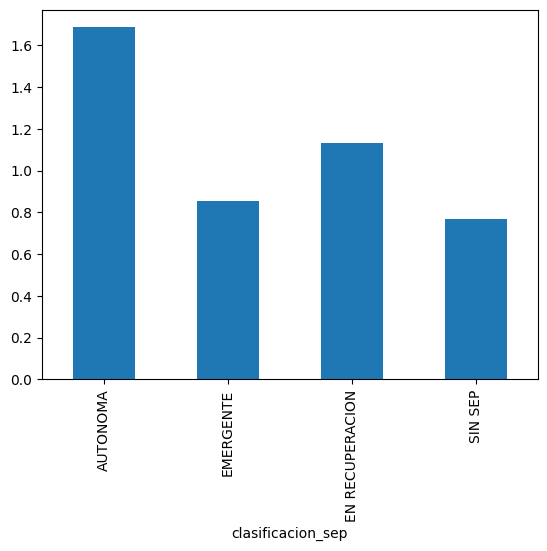

In [65]:
sep_mean_denun.plot(kind="bar")

In [147]:
sep_mean_denun.reset_index()

,clasificacion_sep,total_denuncias
0,AUTONOMA,1.686724
1,EMERGENTE,0.852769
2,EN RECUPERACION,1.130170
3,SIN SEP,0.766491


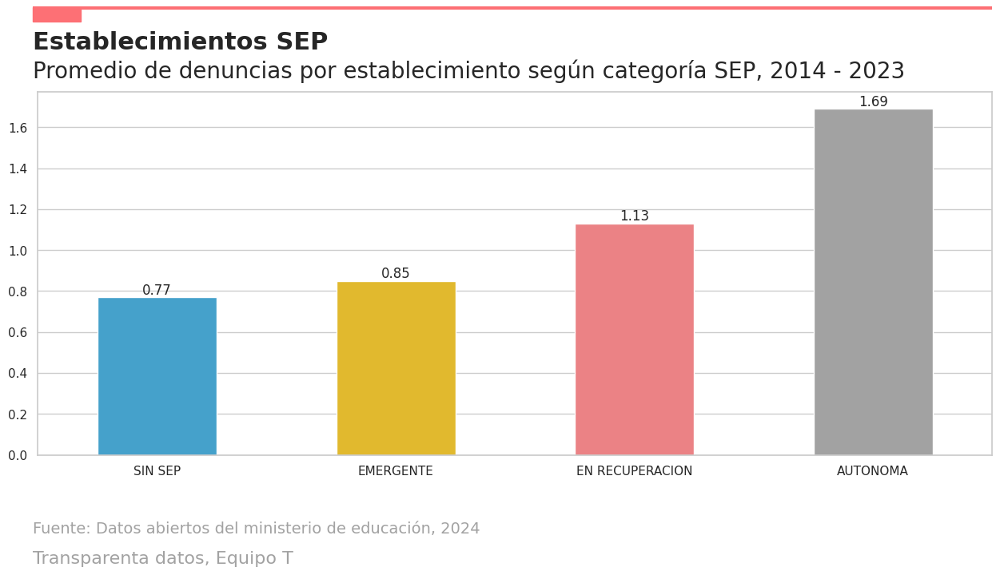

In [150]:

from matplotlib import lines
from matplotlib import patches
from matplotlib.patheffects import withStroke

PINK = "#fd7075"
LIGHT_BLUE = "#2faae1"
YELLOW = "#ffc910"
BLACK = "#000000"

round_sep_mean_denun = sep_mean_denun.reset_index()
round_sep_mean_denun["total_denuncias"] = round_sep_mean_denun["total_denuncias"].apply(lambda x: round(x,2))



LINE_TITLE_COLOR = "#fd7075"
BLACK = "#202020"
GREY = "#a2a2a2"
font_family = "DejaVu Sans"

fig, ax = plt.subplots(figsize=(12, 7))

sns.barplot(x = "clasificacion_sep", y = "total_denuncias", hue="clasificacion_sep",data= round_sep_mean_denun.sort_values(by="total_denuncias"), palette=[LIGHT_BLUE, YELLOW, PINK, GREY], width=0.5)

for i in ax.containers:
    ax.bar_label(i,)


ax.set_ylabel("")
ax.set_xlabel("")
fig.subplots_adjust(left=0.005, right=1, top=0.85, bottom=0.2)

# Add title
fig.text(
    0, 0.925, "Establecimientos SEP",
    fontsize=22, fontweight="bold",fontfamily = font_family,
)
# Add subtitle
fig.text(
    0, 0.875, "Promedio de denuncias por establecimiento según categoría SEP, 2014 - 2023",
    fontsize=20,fontfamily = font_family,
)

# Add caption

fig.text(
    0, 0.06, "Fuente: Datos abiertos del ministerio de educación, 2024",color=GREY,
    fontsize=14,fontfamily = font_family,
)

fig.text(
    0, 0.005, "Transparenta datos, Equipo T", color=GREY,
    fontsize=16,fontfamily = font_family,
)

# Add line and rectangle on top.
fig.add_artist(lines.Line2D([0, 1], [1, 1], lw=3, color=LINE_TITLE_COLOR, solid_capstyle="butt"))
fig.add_artist(patches.Rectangle((0, 0.975), 0.05, 0.025, color=LINE_TITLE_COLOR))


In [66]:
boolsep_mean_denun = estab_denun_matr_agno_rbd.groupby("boolean_class_sep")[
    "total_denuncias"
].mean()

<Axes: title={'center': 'Promedio de denuncias según participación SEP'}, xlabel='boolean_class_sep'>

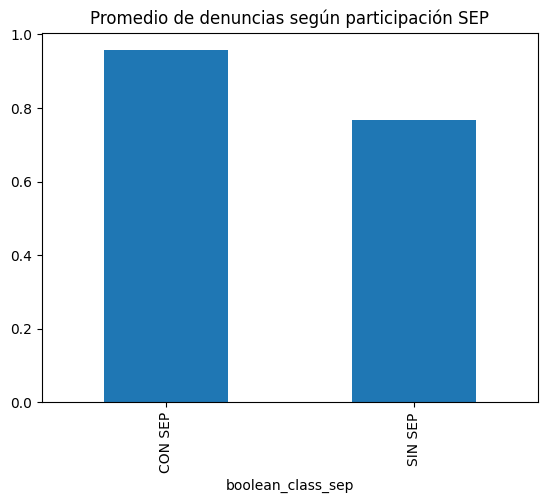

In [67]:
boolsep_mean_denun.plot(
    kind="bar", title="Promedio de denuncias según participación SEP"
)

In [89]:
boolsep_mean_denun.reset_index()

,boolean_class_sep,total_denuncias
0,CON SEP,0.956706
1,SIN SEP,0.766491


In [108]:
## COLORS



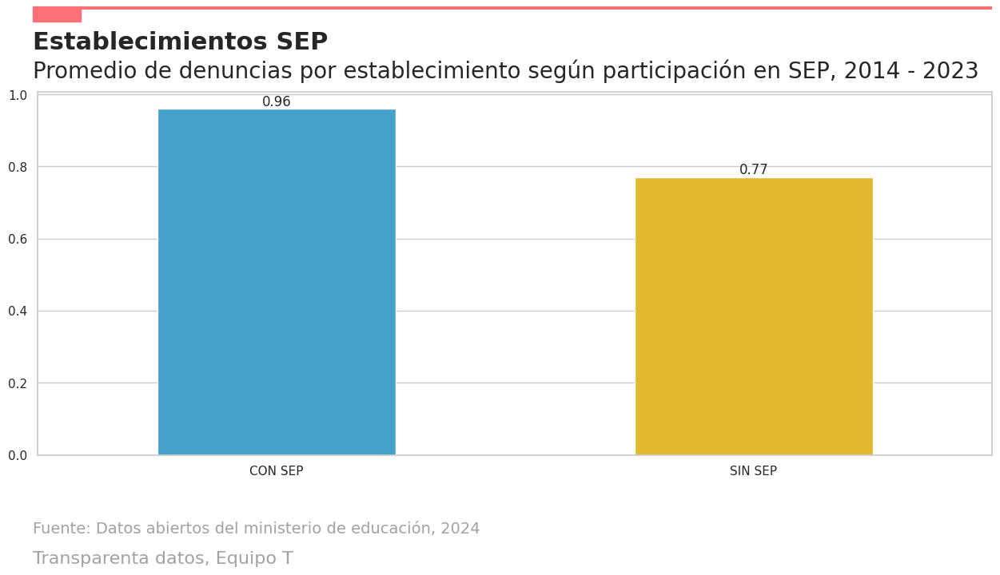

In [145]:



from matplotlib import lines
from matplotlib import patches
from matplotlib.patheffects import withStroke

PINK = "#fd7075"
LIGHT_BLUE = "#2faae1"
YELLOW = "#ffc910"
BLACK = "#000000"

round_boolsep_mean_denun = boolsep_mean_denun.reset_index()
round_boolsep_mean_denun["total_denuncias"] = round_boolsep_mean_denun["total_denuncias"].apply(lambda x: round(x,2))

LINE_TITLE_COLOR = "#fd7075"
BLACK = "#202020"
GREY = "#a2a2a2"
font_family = "DejaVu Sans"

fig, ax = plt.subplots(figsize=(12, 7))

sns.barplot(x = "boolean_class_sep", y = "total_denuncias", hue="boolean_class_sep",data= round_boolsep_mean_denun, palette=[LIGHT_BLUE, YELLOW], width=0.5)

for i in ax.containers:
    ax.bar_label(i,)


ax.set_ylabel("")
ax.set_xlabel("")
fig.subplots_adjust(left=0.005, right=1, top=0.85, bottom=0.2)

# Add title
fig.text(
    0, 0.925, "Establecimientos SEP",
    fontsize=22, fontweight="bold",fontfamily = font_family,
)
# Add subtitle
fig.text(
    0, 0.875, "Promedio de denuncias por establecimiento según participación en SEP, 2014 - 2023",
    fontsize=20,fontfamily = font_family,
)

# Add caption

fig.text(
    0, 0.06, "Fuente: Datos abiertos del ministerio de educación, 2024",color=GREY,
    fontsize=14,fontfamily = font_family,
)

fig.text(
    0, 0.005, "Transparenta datos, Equipo T", color=GREY,
    fontsize=16,fontfamily = font_family,
)

# Add line and rectangle on top.
fig.add_artist(lines.Line2D([0, 1], [1, 1], lw=3, color=LINE_TITLE_COLOR, solid_capstyle="butt"))
fig.add_artist(patches.Rectangle((0, 0.975), 0.05, 0.025, color=LINE_TITLE_COLOR))


In [97]:
estab_denun_matr_agno_rbd.groupby("boolean_class_sep").agg({"total_denuncias":"sum"})

,total_denuncias
boolean_class_sep,
CON SEP,151546
SIN SEP,10156


In [69]:
estab_denun_matr_agno_rbd["mean_den_sep"] = estab_denun_matr_agno_rbd[
    "clasificacion_sep"
].map(sep_mean_denun)

In [70]:
df_denun_sep_forgraph = estab_denun_matr_agno_rbd[
    ["clasificacion_sep", "total_denuncias", "mean_den_sep"]
].dropna()

In [71]:
df_denun_sep_forgraph["clasificacion_sep"].unique().tolist()

['EMERGENTE', 'EN RECUPERACION', 'SIN SEP', 'AUTONOMA']

In [72]:
!uv pip install plotly

Audited 1 package in 282ms


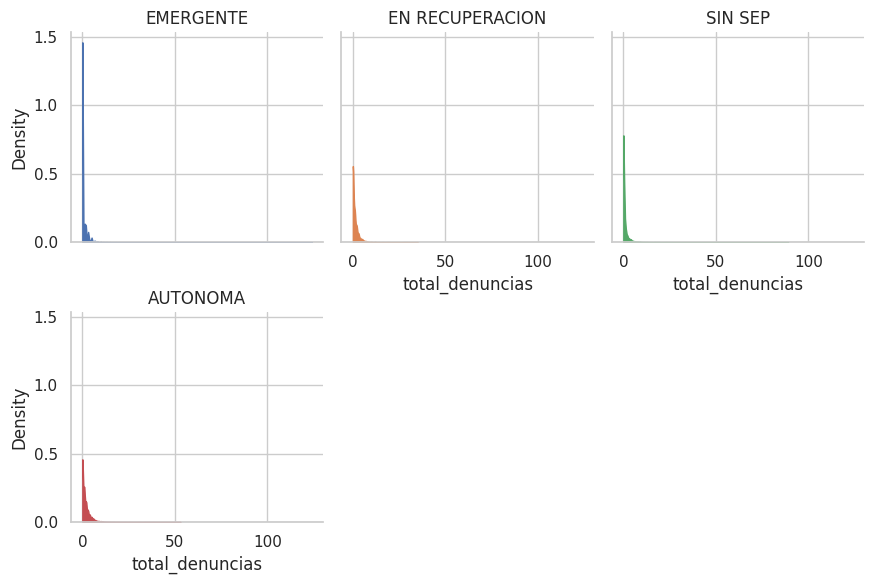

In [73]:
import matplotlib.pyplot as plt

# set seaborn whitegrid theme
sns.set_theme(style="whitegrid")

# using small multiple
# create a grid
g = sns.FacetGrid(
    df_denun_sep_forgraph, col="clasificacion_sep", hue="clasificacion_sep", col_wrap=3
)

# draw density plots
g = g.map(
    sns.kdeplot,
    "total_denuncias",
    cut=0,
    fill=True,
    common_norm=False,
    alpha=1,
    legend=False,
)

# control the title of each facet
g = g.set_titles("{col_name}")

# show the graph
plt.show()

In [74]:
df_denun_sep_forgraph.head(1)

,clasificacion_sep,total_denuncias,mean_den_sep
0,EMERGENTE,2,0.852769
